# Parameter investigation

This notebook is going to be the analysis and investigation into what parameters are important to the model before the model has been created. It is an important first step to see what should be included, firstly I will look at colinearity and potentially principal component analysis.

## Colinearity of variables.

In [5]:
# Import modules
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import pylab as pl

In [9]:
# Import the data from the parquet file
data = pd.read_parquet("./data/all_data.parquet")
data = data.drop(columns=["back_pressure", "back_temperature"])
data.tail()

,total_pressure,mass_flow_rate,velocity,total_temp,UHTE,dynamic_viscosity,kinematic_viscosity,density,rpm,acceleration
716,1.878673,0.022277,28.078894,583.52450,3.384054,0.000028,0.000025,1.121647,4000.0,-249.182579
717,1.877628,0.022255,28.070396,583.50476,3.375693,0.000028,0.000025,1.121062,4000.0,-354.188790
718,1.876585,0.022232,28.055107,583.48510,3.367469,0.000028,0.000025,1.120480,4000.0,-535.900210
719,1.875571,0.022206,28.037727,583.46590,3.358645,0.000028,0.000025,1.119913,4000.0,-570.924916
720,1.874655,0.022182,28.020618,583.44860,3.350432,0.000028,0.000025,1.119401,4000.0,-631.889765


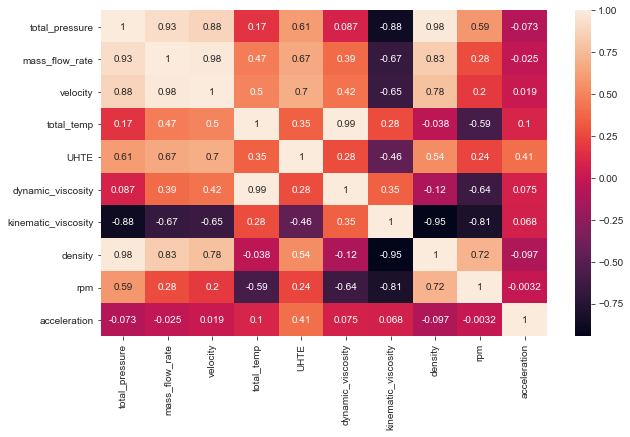

In [11]:
# Let's plot the correlation of the data set using a heatmap from seaborn library.

corr_data = data.corr()
plt.figure(figsize=(10, 6)) # this is literally just the size of the plot, nothing to do with the dimensions. 
sns.set_style('ticks')
sns.heatmap(corr_data, annot=True)
plt.savefig("./output_graphs/colinearity.png")
plt.show()

# This plot is a plot of each variables correlation with one another. Hence the 1 down the main diagonal. It gives us an idea of which variables are going to affect the dependent variable. 

## Principal component analysis


In [13]:
# For PCA, standardizing (normalizing) the data set is required. 
from sklearn.preprocessing import StandardScaler

In [23]:
# Features to normalise
features = data.columns.tolist()
features.remove("UHTE")
print(features)

['total_pressure', 'mass_flow_rate', 'velocity', 'total_temp', 'dynamic_viscosity', 'kinematic_viscosity', 'density', 'rpm', 'acceleration']


In [26]:
# separate into input and output

# inputs
x = data.loc[:, features].values

# output, UHTE
y = data.loc[:, ["UHTE"]].values

# Standardize the inputs
x = StandardScaler().fit_transform(x)


In [80]:
# Project into two dimensions. No meaning is assigned to each axis. 

from sklearn.decomposition import PCA

pca = PCA(n_components = 2)

principalComponents = pca.fit_transform(x)

principal_df = pd.DataFrame(data = principalComponents, columns = ["PC1", "PC2"],)

principal_df.reset_index(drop = True, inplace = True)

print(principal_df.shape)

principal_df.head()

(60225, 2)


,PC1,PC2
0,-2.798026,1.559452
1,-2.798041,1.558928
2,-2.798099,1.558734
3,-2.798143,1.558354
4,-2.798225,1.557780


In [57]:
target_df = data[["UHTE"]]
target_df.reset_index(drop = True, inplace = True)
print(target_df.shape)
target_df.head()

(60225, 1)


,UHTE
0,1.034879
1,1.029407
2,1.019855
3,1.023269
4,1.035842


In [62]:
from mpl_toolkits.mplot3d import Axes3D

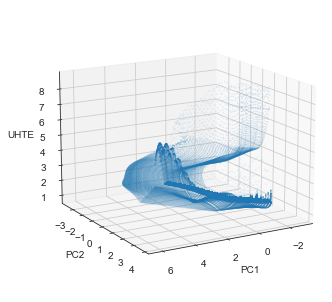

In [75]:
fig = plt.figure()
ax = Axes3D(fig)
xs = list(principal_df.PC1)
ys = list(principal_df.PC2)
zs = list(target_df.UHTE)
ax.scatter(xs, ys, zs, s=0.01)
#ax.plot(x_space, y_space, line_data, color="gold")
plt.xlabel("PC1")
plt.ylabel("PC2")
ax.set_zlabel("UHTE")
ax.view_init(15, 60)
plt.savefig("./output_graphs/pca.png")
plt.show()

In [66]:
# Calculate the explained variance of both pcs.
pca.explained_variance_ratio_

array([0.53191517, 0.3292682 ])

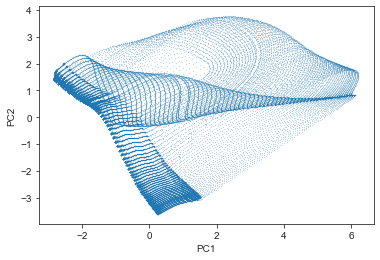

In [73]:
plt.scatter(principal_df.PC1, principal_df.PC2, s=0.01)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.savefig("./output_graphs/pc1vspc2.png")
plt.show()

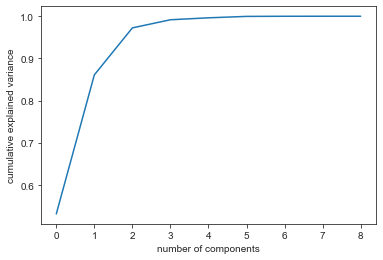

In [78]:
#Explained variance
pca = PCA().fit(x)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.savefig("./output_graphs/components_vs_ex_var.png")
plt.show()

In [81]:
# According to graph above, 3 components can describe the data, so let's try that. 
pca = PCA(n_components = 3)

principalComponents = pca.fit_transform(x)

principal_df = pd.DataFrame(data = principalComponents, columns = ["PC1", "PC2", "PC3"],)

print(principal_df.shape)

principal_df.head()

(60225, 3)


,PC1,PC2,PC3
0,-2.798026,1.559452,-0.209864
1,-2.798041,1.558928,-0.211323
2,-2.798099,1.558734,-0.212074
3,-2.798143,1.558354,-0.210500
4,-2.798225,1.557780,-0.210632


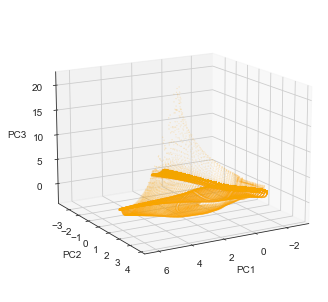

In [83]:
fig = plt.figure()
ax = Axes3D(fig)
xs = list(principal_df.PC1)
ys = list(principal_df.PC2)
zs = list(principal_df.PC3)
ax.scatter(xs, ys, zs, s=0.01, color = "orange")
plt.xlabel("PC1")
plt.ylabel("PC2")
ax.set_zlabel("PC3")
ax.view_init(15, 60)
plt.savefig("./output_graphs/pca_3_vars.png")
plt.show()